<a href="https://colab.research.google.com/github/Nikhiljain201/Dog_Vision/blob/main/Dog_Vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

print("The version is  : " , tf.__version__)
print("The version is  : " , hub.__version__)

#Check for GPU availability
print("GPU" , " Available" if tf.config.list_physical_devices else "Not Available")

The version is  :  2.4.0
The version is  :  0.10.0
GPU  Available


# New Section




Getting our Data Ready(Turning into tensors)

With all machine learning our data has to be in Numerical format. That is what we will be doing first 
turning our images into Tensors(numerical representations)

Starting off by accessing data and checking out the 
labels.

In [ ]:
#Checkout the labels of our data
import pandas as pd;

labels_csv = pd.read_csv("/content/drive/MyDrive/Dog Vision/labels.csv")
print(labels_csv.describe())
labels_csv.head()

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     33d84db8872f7ba0877f868a0b341554  scottish_deerhound
freq                                   1                 126


,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
labels_csv['breed'].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
komondor                 67
golden_retriever         67
brabancon_griffon        67
briard                   66
eskimo_dog               66
Name: breed, Length: 120, dtype: int64

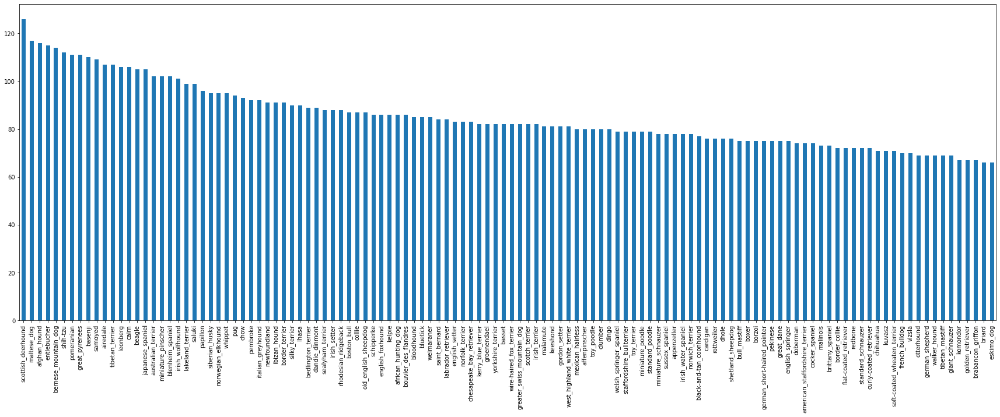

In [ ]:
labels_csv['breed'].value_counts().plot.bar(figsize=(30 , 10))

In [ ]:
#The median number of images per class
labels_csv['breed'].value_counts().median()

82.0

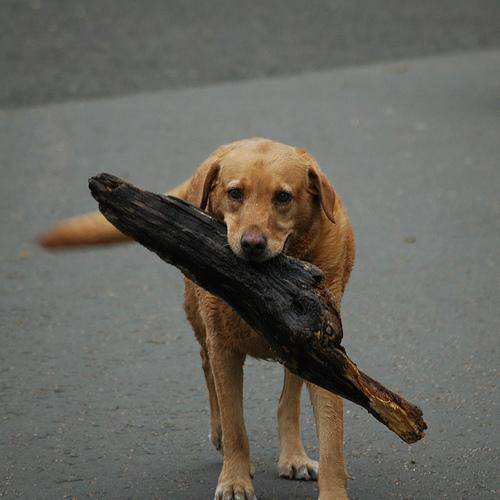

In [ ]:
from IPython.display import Image
Image("/content/drive/MyDrive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg")

In [ ]:
filenames = ['/content/drive/My Drive/Dog Vision/train/' + fname + ".jpg" for fname in labels_csv['id']]

filenames[:10]

['/content/drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/My Drive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/My Drive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/My Drive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/My Drive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/My Drive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
#Checking if the filenames match the length of the list
import os
if len(os.listdir("/content/drive/My Drive/Dog Vision/train/")) == len(filenames):
  print("Filenames match actual amount of files.. Proceed")
else:
  print("Filenames do not match")

Filenames match actual amount of files.. Proceed


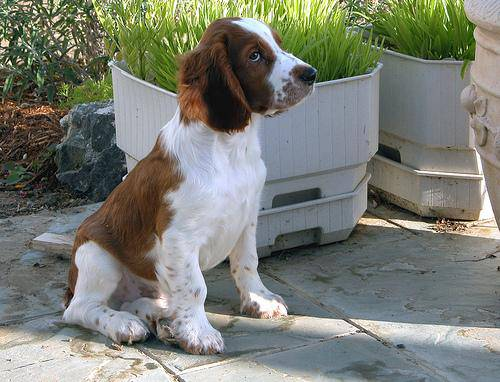

In [ ]:
Image(filenames[123])

In [ ]:
#Since we have got our training image filepaths.. We prepare our labels
import numpy as np
labels = labels_csv['breed'].to_numpy()
#Method2 labels = np.array(labels)
print(len(labels))

10222


In [ ]:
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
if len(labels) == len(filenames):
  print("Proceed!!!")
else:
  print("Check the lengths again")

Proceed!!!


In [ ]:
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
#Converting into bools
print(labels[0])

labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
#Converted each label into it's boolean label
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
#Turning boolean into integers
print(labels[0]) #Origianl Label
print(np.where(unique_breeds == labels[0])) #Locates the postion
print(boolean_labels[0].argmax()) #index where the label occurs in boolean array
print(boolean_labels[0].astype(int)) #there will be 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[1])
print(np.where(unique_breeds == labels[1]))
print(boolean_labels[1].argmax())
print(boolean_labels[1].astype(int))

dingo
(array([37]),)
37
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


# **Creating our own Validation Set**

creating our own validation sets

**We are going to start off experimenting with 1000 images and increase it as we need**

In [ ]:
#Setting up X and y
x = filenames 
y = boolean_labels

In [ ]:
NUM_IMAGES = 1000 #@param {type:"slider" , min:1000 , max:10000 , step:1000}

In [ ]:
#Spliting our data into train and validation sets
from sklearn.model_selection import train_test_split
#Split them into train and validation sets
x_train , x_validation, y_train,  y_validation = train_test_split(x[:NUM_IMAGES] , y[:NUM_IMAGES] , test_size = 0.2 , random_state = 42)

len(x_train) , len(x_validation) , len(y_train) , len(y_validation)

(800, 200, 800, 200)

In [ ]:
x_train[:2] , y_train[:2]

(['/content/drive/My Drive/Dog Vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/My Drive/Dog Vision/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, Fals

# Preprocessing Images(tuning images into tensors)

In order to preprocess our images into tensors, we're going to write a 
function which does a few things:

1. Take an image filepath as input
2. Use Tensorflow to read a file and save it to the variable `Image`
3. Turn our `Image` (a jpg) into tensors
4. Normalize our image (Convert color channel values from 0-255 to 0-1)
5. Resize the `Image` to be a shape of(224, 224)
6. Return the modified image

In [ ]:
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
image.max() , image.min()

(255, 0)

In [ ]:
image

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  53],
        [ 97,  88,  49],
        [120, 111,  72]]

In [ ]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [ ]:
#Define Image Size
IMG_SIZE = 224

#Creating a function for preprocessing
def process_images(image_path):
  """
  Takes an image into a file path and turns the image into tensors
  
  """  
  #Reading an image path
  image = tf.io.read_file(image_path)

  #Turn the jpg image into tensors
  #image = tf.image.decode_jpeg(image , channels=3)
  image = tf.image.decode_jpeg(image , channels=3)
  #convert the colour channel values from 0-255 to 0-1 values
  #image = tf.image.convert_image_dtype(image , tf.float32)
  image = tf.image.convert_image_dtype(image , tf.float32)
  #Resize the image to the desired value
  #image = tf.image.resize(image ,  size=[IMG_SIZE , IMG_SIZE])
  image = tf.image.resize(image , size = [IMG_SIZE , IMG_SIZE])

  return image

In [ ]:
image1 = process_images(filenames[42])
image1

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[0.3264178 , 0.5222886 , 0.3232816 ],
        [0.2537167 , 0.44366494, 0.24117757],
        [0.25699762, 0.4467087 , 0.23893751],
        ...,
        [0.29325107, 0.5189916 , 0.3215547 ],
        [0.29721776, 0.52466875, 0.33030328],
        [0.2948505 , 0.5223015 , 0.33406618]],

       [[0.25903144, 0.4537807 , 0.27294815],
        [0.24375686, 0.4407019 , 0.2554778 ],
        [0.2838985 , 0.47213382, 0.28298813],
        ...,
        [0.2785345 , 0.5027992 , 0.31004712],
        [0.28428748, 0.5108719 , 0.32523635],
        [0.28821915, 0.5148036 , 0.32916805]],

       [[0.20941195, 0.40692952, 0.25792548],
        [0.24045378, 0.43900946, 0.2868911 ],
        [0.29001117, 0.47937486, 0.32247734],
        ...,
        [0.26074055, 0.48414773, 0.30125174],
        [0.27101526, 0.49454468, 0.32096273],
        [0.27939945, 0.5029289 , 0.32934693]],

       ...,

       [[0.00634795, 0.03442048, 0.0258106 ],
        [0.01

In [ ]:
#tensor = tf.image.decode_jpeg(image1 , channels = 3)
#tf.image.convert_image_dtype(tensor , tf.float32)
#tf.image.resize(tensor , size = [224 ,  224])

# Turning Data into Batches

Why turning our data into batches??

If we try to process 10,000+ images in one go.. They might not fit into 
the memory.

That is the reason why we do 32(batch size) images at a time(we can manually adjust the batch size of need be)

In order to use Tensorflow effectively, we need our data in the form of tensor tuples which looks like:

  `(image , labels)`

In [ ]:
#Creating a simple function that returns a tuple of tensors
def get_image_label(image_path,label):
  
  """
  Takes an image file path name and the associated label, processes then image
  and returns the tuple of (images and labels).
  """
  image = process_images(image_path)
  return image,label

In [ ]:
(process_images(x[42]) , tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now that we have a way to turn our data into tuple of Tensors in the form: `(image,label)` , let's make a function to  turn all of our data 
(`x` and `y`) into batches of size 32

In [ ]:
#Defining a batch size, 32 is a good start 
BATCH_SIZE = 32

#creating a function to turn data into batches
def create_data_batches(x , y=None , batch_size = BATCH_SIZE , valid_data = False , test_data = False):
  """
  Creates batches of data out of image (x) and label(y) pairs.
  Shuffles the data if it's the training data but doesn't shuffle it it is 
  validation data. Also accepts test data as input(no labels).
  """
  #if the data is a test dataset ,  we probably don't have labels
  if test_data:
    print("Creating test data batches....")
    #data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) #only filepaths(no labels)
    #data_batch = data.map(process_images).batch(BATCH_SIZE)
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    data_batch = data.map(process_images).batch(BATCH_SIZE)
    return data_batch

  elif valid_data:
    print("Creating validation data batches...")
    #data = tf.data.Dataset.from_tensor_slices((tf.constant(x) , #Filepaths 
                                               #tf.constant(y))) #labels
    #data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x) , tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    #data = tf.data.Dataset.from_tensor_slices((tf.constant(x) , #filepaths 
                                              # tf.constant(y))) #labels
    #data = data.shuffle(buffer_size = len(x))

    #Create (image, label) tuples(this also turns the image path into a preprocessed image)
    #data = data.map(get_image_label)

    #data_batch = data.batch(BATCH_SIZE)

    data = tf.data.Dataset.from_tensor_slices((tf.constant(x) , tf.constant(y)))
    data = data.shuffle(buffer_size = len(x))
    data = data.map(get_image_label)
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
#Creating training and validation data batches
train_data = create_data_batches(x_train , y_train)
validation_data = create_data_batches(x_validation , y_validation , valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
#Check out the different attributes of our data batches
train_data.element_spec , validation_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

# Visualising Data Batches

Our data is in batches, however it can be hard to comprehend, that is the reason why we visualize our data.

In [ ]:
import matplotlib.pyplot as plt

#Creating a function for viewing images in a data batch

def show_25_images(images , labels):
  """
  Displays a plot of 25 images and there labels from a data batch
  """

  #Setup the figure
  plt.figure(figsize=(10 , 10))

  #Looping through 25 (for displaying 25 images)
  for i in range(25):
    #create subplots
    ax = plt.subplot(5, 5, i+1)

    #Display images
    plt.imshow(images[i])

    #Adding the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])  

    #Turn the grids lines off
    plt.axis("off")

  

In [ ]:
unique_breeds[y[12].argmax()]

'maltese_dog'

In [ ]:
train_images , train_labels = next(train_data.as_numpy_iterator())
train_images , train_labels

(array([[[[4.02291238e-01, 4.38898414e-01, 2.33061984e-03],
          [3.96745920e-01, 4.28204924e-01, 5.26512302e-02],
          [4.34476793e-01, 4.57025796e-01, 1.52859122e-01],
          ...,
          [1.49954483e-01, 6.76015392e-02, 0.00000000e+00],
          [2.24230736e-01, 1.30113065e-01, 2.42205244e-02],
          [2.79411793e-01, 1.77450985e-01, 7.94117674e-02]],
 
         [[3.33987653e-01, 3.97116840e-01, 5.65476194e-02],
          [3.22483391e-01, 3.78684163e-01, 1.06815711e-01],
          [3.32505047e-01, 3.81034464e-01, 1.71565354e-01],
          ...,
          [1.70128495e-01, 8.77755657e-02, 0.00000000e+00],
          [2.56042093e-01, 1.61924437e-01, 5.21205179e-02],
          [2.68872559e-01, 1.66911766e-01, 6.88725561e-02]],
 
         [[2.49719903e-01, 3.33067447e-01, 7.31026828e-02],
          [2.04675481e-01, 2.83399016e-01, 8.35291967e-02],
          [1.75161943e-01, 2.41338417e-01, 9.84834656e-02],
          ...,
          [1.79310292e-01, 9.69573632e-02, 0.0000

In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

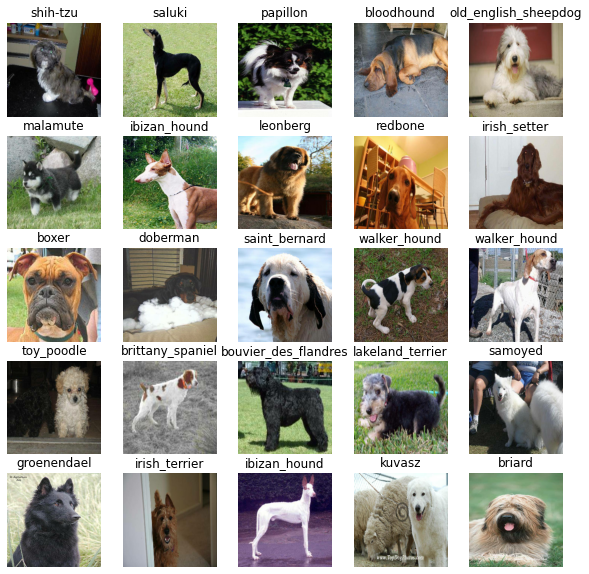

In [ ]:
#Now visualising our data in the training path
show_25_images(train_images , train_labels)

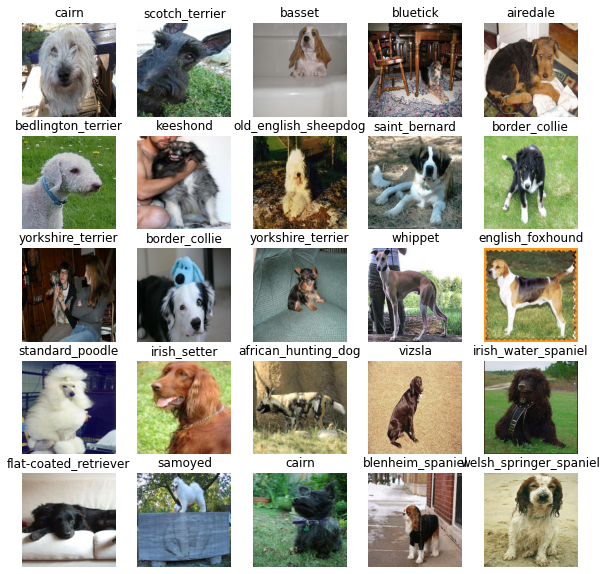

In [ ]:
valid_images , valid_labels = next(validation_data.as_numpy_iterator())
show_25_images(valid_images , valid_labels)

# Building a model

Before we build a model ,  there are a few things we need to keep to define:
* The `input` shape(our images shape, in the form of tensors)to our model.
* The output shape (image labels, in the form of tensors) of our model.
* The URL of the model we want to use from tensorflow hub.

In [ ]:
#Setup input shape to the model
INPUT_SHAPE = [None , IMG_SIZE , IMG_SIZE , 3] #Batch, width , height, colour channels

#Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

#Setup Model URL from tensorflow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"


In [ ]:
len(unique_breeds)

120

Now we have the inputs the outputs and the model, we can put them all
together in a Keras Deep Learning Model:

We create a function where:
* Takes the input shape, output shape and the model we've chosen as 
parameters.
* Defines the layers in a Keras model in Sequential Fashion.(Do this first and follow up with the next).
* Compile the model(It should be evaluated and improved).
* Builds a model(Tells the model the input shape it will be getting).
* Return the model.

In [ ]:
def custom_model(input_shape = INPUT_SHAPE , output_shape = OUTPUT_SHAPE , model_url = MODEL_URL):
  print("Building model with: " , MODEL_URL)

  #Setup the model layers
  model = tf.keras.Sequential([hub.KerasLayer(MODEL_URL),
          tf.keras.layers.Dense(units = OUTPUT_SHAPE, 
                                activation = "softmax")])
  
  #Compile the model
  model.compile(loss = tf.keras.losses.CategoricalCrossentropy(),
                optimizer = tf.keras.optimizers.Adam(),
                metrics = ['accuracy'])
  

  #Build the model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = custom_model()
model.summary()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


# Creating Callbacks

Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress or stop training a model early if a model stops improving 

Two callbacks are created, One for tensorboard which helps track our models progress and another for early stopping which prevents our model for training too long.

# TensorBoard Callback
3 Things to do:
1. Load the tensorboard notebook
2. Create a Tensorboard callback which is able to save logs to a dictionary and pass it to our models `fit()` function.
3. Visualize our models training logs with the `%tensorboard` magic function(Doing this after model training)

In [ ]:
%load_ext tensorboard 

In [ ]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  #Create a log directory for storing tensorboard logs
  logdir = os.path.join("/content/drive/MyDrive/Dog Vision/logs" , datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

  return tf.keras.callbacks.TensorBoard(logdir)


# Early Stopping Callback

Early stopping helps to stop our model if there is no improvments noticed during a period of epochs(time)

In [ ]:
#Create Early stopping
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy' , 
                                                  patience = 10)

# Training a Data

Firstly we train the data with 1000 images

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:1}

# Creating a function that trains a model

* Create a model using `create_model()`
* Setup a TensorBoard Callback using `create_tensorboard_callback()`
* Call the `fit()` function on the model passing it passing the training data, validation data, number of epochs to train for and the callbacks we'd like to use
* Return the model

In [ ]:
#Build a function to train and return the trained model

def train_model():
  '''
  Trains a given model and returns the trained model
  
  '''
  #Create model
  model = custom_model()

  #Create new Tensorboard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #Fit the model to the data passing it the callback we created
  model.fit(x = train_data , epochs= NUM_EPOCHS , validation_data = validation_data , validation_freq=1 , callbacks=[tensorboard , early_stopping])

  return model

In [ ]:
#Fit the model to the data
model = train_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 375s 15s/step - loss: 5.1663 - accuracy: 0.0488 - val_loss: 3.4387 - val_accuracy: 0.1900
Epoch 2/100
25/25 [==============================] - 5s 186ms/step - loss: 1.9466 - accuracy: 0.6144 - val_loss: 2.1249 - val_accuracy: 0.4850
Epoch 3/100
25/25 [==============================] - 5s 185ms/step - loss: 0.6917 - accuracy: 0.9128 - val_loss: 1.6300 - val_accuracy: 0.5700
Epoch 4/100
25/25 [==============================] - 5s 184ms/step - loss: 0.2626 - accuracy: 0.9925 - val_loss: 1.4332 - val_accuracy: 0.6050
Epoch 5/100
25/25 [==============================] - 5s 185ms/step - loss: 0.1494 - accuracy: 0.9997 - val_loss: 1.3424 - val_accuracy: 0.6300
Epoch 6/100
25/25 [==============================] - 5s 183ms/step - loss: 0.1026 - accuracy: 1.0000 - val_loss: 1.3012 - val_accuracy: 0.6300
Epoch 7/100
25/25 [=============================

# Checking the TensorBoard logs

The tensorboard magic function (%tensorboard) will access the logs directory we created and visualise the contents

In [ ]:
%tensorboard --logdir drive/My\ Drive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

# Making and evaluating predictions using a trained model

In [ ]:
#Make predictions on the validation data(Not used to train)
predictions = model.predict(validation_data , verbose = 1)
predictions

7/7 [==============================] - 1s 132ms/step


array([[9.97732161e-04, 5.73404432e-05, 2.58509710e-04, ...,
        9.72029447e-05, 9.78537719e-06, 4.52508219e-03],
       [2.94939056e-03, 5.39689267e-04, 5.26908133e-03, ...,
        1.98844325e-04, 5.85569593e-04, 1.62972356e-05],
       [1.70221000e-07, 4.03345211e-06, 2.04025423e-06, ...,
        3.71855890e-06, 2.72699276e-06, 1.17108786e-04],
       ...,
       [3.07822233e-07, 2.22712788e-06, 3.87754744e-06, ...,
        1.95215264e-07, 1.46630628e-05, 4.77514050e-06],
       [4.72044293e-03, 2.90616736e-04, 6.15017416e-05, ...,
        5.70472948e-05, 1.40503998e-05, 4.14143875e-03],
       [1.53032248e-04, 7.13323016e-06, 2.00696450e-04, ...,
        1.89805590e-03, 2.51998164e-04, 1.13521071e-06]], dtype=float32)

In [ ]:
index = 22

print(predictions[index])
print(f"The maximum predicted value is : {np.max(predictions[index])}")
print(f"The sum is : {np.sum(predictions[index])}")
print(f"The index value is : {np.argmax(predictions[index])}")
print(f"The predicted label is : {unique_breeds[np.argmax(predictions[index])]}")

[6.43630773e-02 8.98463913e-05 2.44066559e-05 1.17675709e-05
 1.47877436e-04 6.99600946e-07 1.78946659e-03 5.37200758e-05
 5.28992750e-05 7.99951376e-05 4.98501777e-06 2.62678568e-05
 4.48907122e-05 6.15637109e-05 3.70579801e-06 7.93024265e-06
 1.33965746e-04 1.10907608e-03 1.23765199e-06 8.00639027e-05
 1.77158377e-04 1.21952944e-05 5.44463801e-05 1.99017322e-05
 2.57895063e-05 5.59117361e-05 6.78584397e-01 1.08469932e-04
 2.30137289e-06 5.98513114e-04 8.04626598e-06 8.68176267e-06
 1.39034837e-05 1.87834905e-06 7.70987936e-06 6.34737444e-05
 6.90968727e-06 2.62742451e-05 2.17778256e-06 5.59198179e-06
 2.46447835e-05 8.40357825e-06 2.71331214e-06 4.30347245e-06
 3.81486061e-05 4.69660707e-04 2.69162183e-06 9.71699933e-07
 3.77132994e-04 2.77013305e-06 5.48572143e-06 8.60260025e-06
 1.60636739e-06 2.84311454e-06 4.12650006e-05 8.77584353e-06
 6.82653717e-06 6.50756047e-05 2.82364726e-05 4.46259401e-05
 1.07190835e-05 3.55871748e-07 1.04672974e-04 2.55817986e-06
 1.45810322e-04 1.921068

In [ ]:
#Turn prediction probabilities into their respective label 
def get_pred_label(prediction_probabilities): 
  """
  Turns an array of predictions into a label
  """

  return unique_breeds[np.argmax(prediction_probabilities)]

pred_label = get_pred_label(predictions[51])
pred_label

'weimaraner'

Since the validation data is in the form of a batch, We need to unbatch them.

In [ ]:
#Function
def unbatching(val_data):
  images = []
  labels = []

  for image , label in val_data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  

  return images,labels

In [ ]:
val_images,val_labels = unbatching(validation_data)

In [ ]:
val_images[0] , val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
 images_ = []
labels_ = []

for images,labels in validation_data.unbatch().as_numpy_iterator():
  images_.append(images)
  labels_.append(labels)

images_[0] , labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
get_pred_label(labels_[45])

'groenendael'

In [ ]:
get_pred_label(predictions[45])

'groenendael'

Trying to visualise our predictions using the function that we create

* Takes an array of prediction probabilities, an array of truth labels and an array of integers and images.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, it's predicted probability, the truth label and the target image on a single plot

In [ ]:
def plot_pred(prediction_probabilities,  labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """

  pred_prob , true_label , image = prediction_probabilities[n] , labels[n] , images[n]

  pred_label = get_pred_label(pred_prob)

  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])


  if  (pred_label == true_label):
    color = "green"
  else:
    color = "red"


  plt.title("{} {:2.0f}% {}".format(pred_label , np.max(pred_prob)*100 , true_label) , color = color)


airedale


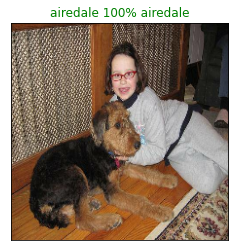

In [ ]:
plot_pred(prediction_probabilities=predictions, labels = val_labels , images = val_images , n = 75)

In [ ]:
predictions[72].argsort()[-10:][::-1]

array([ 15, 113,  39,  12,  93,   9,  47,  89,  42, 118])

In [ ]:
#Creating a function that will give back top 10 prediction probabilities
def plot_pred_conf(prediction_probabilities , labels , n=1):

  pred_prob  = prediction_probabilities[n] 
  true_label = labels[n]
  pred_label = get_pred_label(pred_prob)

  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]

  top_10_pred_values = pred_prob[top_10_pred_indexes]


  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  top_plot = plt.bar(np.arange(len(top_10_pred_labels)) , top_10_pred_values ,  color = 'black')
  plt.xticks(np.arange(len(top_10_pred_labels)) , labels = top_10_pred_labels , rotation = 'vertical')

  #print("Found this")


  if np.isin(true_label , top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

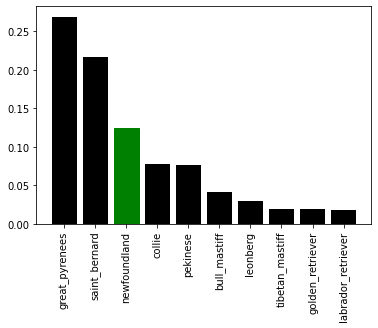

In [ ]:
plot_pred_conf(predictions , val_labels , 71)

yorkshire_terrier
border_collie
yorkshire_terrier
whippet
english_foxhound
standard_poodle


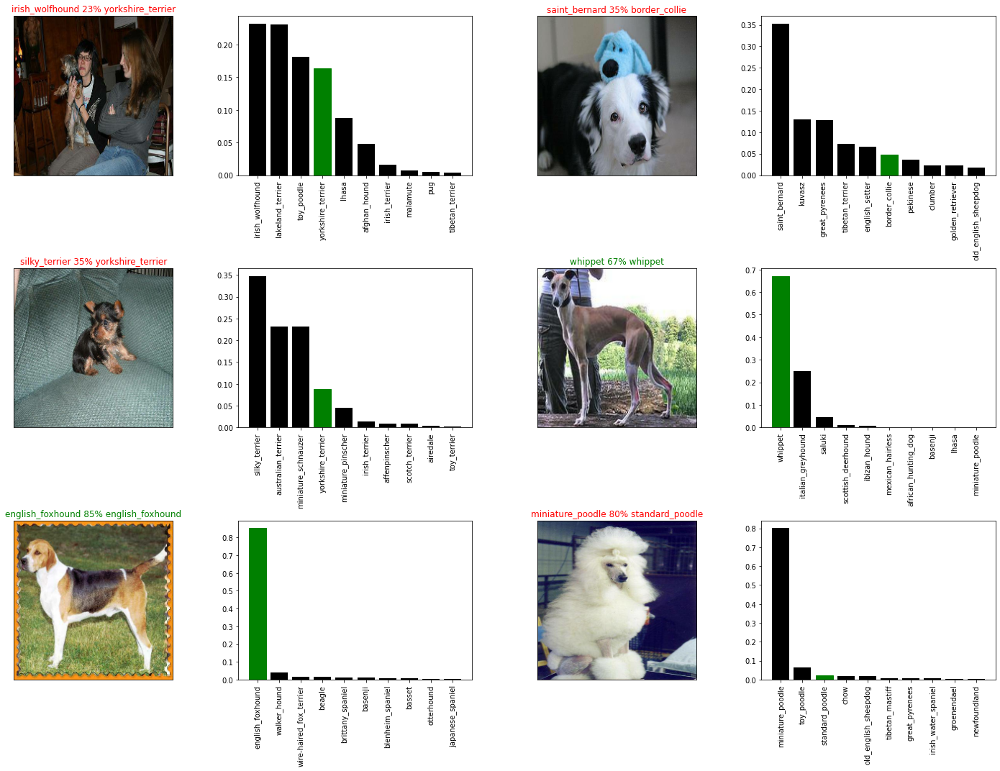

In [ ]:
#Combining both functions
i_multiplier = 10
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols , 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows , 2*num_cols , 2*i+1)
  plot_pred(prediction_probabilities=predictions , labels = val_labels , images= val_images , n = i+i_multiplier)
  plt.subplot(num_rows , 2*num_cols , 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions , labels = val_labels , n = i+i_multiplier)

plt.tight_layout(h_pad = 1.0)
plt.show()

# Saving a Model

In [ ]:
def save_model(model , suffix=None):
  """
  Saves a given model in a models dictionary and appends a suffix
  """

  #Create a model dictionary pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/Dog Vision/models" , datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))

  model_path = modeldir + "-" + suffix + ".h5" #Save format for the model

  print(f"Saving model to: {model_path}....")

  model.save(model_path)

  return model_path

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path 
  """
  print(f"Loading a saved model from:{model_path}")
  model = tf.keras.models.load_model(model_path , custom_objects={"KerasLayer":hub.KerasLayer})

  return model

In [ ]:
save_model(model , suffix = "1000-images-trained-Adam")

Saving model to: /content/drive/MyDrive/Dog Vision/models/20201221-07491608536953-1000-images-trained-Adam.h5....


'/content/drive/MyDrive/Dog Vision/models/20201221-07491608536953-1000-images-trained-Adam.h5'

In [ ]:
loaded_1000_images_model = load_model("/content/drive/MyDrive/Dog Vision/models/20201221-07491608536953-1000-images-trained-Adam.h5")

Loading a saved model from:/content/drive/MyDrive/Dog Vision/models/20201221-07491608536953-1000-images-trained-Adam.h5


In [ ]:
model.evaluate(validation_data)

7/7 [==============================] - 1s 110ms/step - loss: 1.1260 - accuracy: 0.6850


[1.125990390777588, 0.6850000023841858]

In [ ]:
loaded_1000_images_model.evaluate(validation_data)

7/7 [==============================] - 1s 111ms/step - loss: 1.1260 - accuracy: 0.6850


[1.125990390777588, 0.6850000023841858]

# Training the model with the whole dataset

In [ ]:
full_data = create_data_batches(x , y)

Creating training data batches...


In [ ]:
len(x) , len(y)

(10222, 10222)

In [ ]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
#create a model for full model
full_model = custom_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
#create full model callback
full_model_tensorboard = create_tensorboard_callback()
#No validation set when training on all the data, so we can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor = 'accuracy' , 
                                                             patience = 3)

Running the cell below will take time 

In [ ]:
full_model.fit(x = full_data , epochs=NUM_EPOCHS , callbacks=[full_model_tensorboard  , full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 3644s 11s/step - loss: 2.3206 - accuracy: 0.4926
Epoch 2/100
320/320 [==============================] - 38s 118ms/step - loss: 0.3908 - accuracy: 0.8860
Epoch 3/100
320/320 [==============================] - 39s 121ms/step - loss: 0.2282 - accuracy: 0.9373
Epoch 4/100
320/320 [==============================] - 38s 119ms/step - loss: 0.1433 - accuracy: 0.9687
Epoch 5/100
320/320 [==============================] - 38s 118ms/step - loss: 0.1013 - accuracy: 0.9791
Epoch 6/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0750 - accuracy: 0.9890
Epoch 7/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0530 - accuracy: 0.9932
Epoch 8/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0456 - accuracy: 0.9923
Epoch 9/100
320/320 [==============================] - 39s 120ms/step - loss: 0.0358 - accuracy: 0.9967
Epoch 10/100
320/320 [==============================] - 39s 120m

In [ ]:
save_model(full_model , suffix= 'full-image-set-mobilenetv2-adam')

Saving model to: /content/drive/MyDrive/Dog Vision/models/20201221-09181608542326-full-image-set-mobilenetv2-adam.h5....


'/content/drive/MyDrive/Dog Vision/models/20201221-09181608542326-full-image-set-mobilenetv2-adam.h5'

In [ ]:
loaded_full_model = load_model("/content/drive/MyDrive/Dog Vision/models/20201221-09181608542326-full-image-set-mobilenetv2-adam.h5")

Loading a saved model from:/content/drive/MyDrive/Dog Vision/models/20201221-09181608542326-full-image-set-mobilenetv2-adam.h5


# Making a prediction on the test set

Since the model is being trained on the tensor batches to make predictions on the test data, We'll have to get it into the same format.

`create_data_batches()` will help in that regard. 

To make predictions on the test data, We'll:

* Getting the test image filenames
* Convert the filenames into test batches using `create_data_batches()` and setting the `test` data parameter to `true`
* Make a prediction array by passing the test batches to `predict()` method called on our model

In [ ]:
#Load test image filenames 
test_path = "/content/drive/MyDrive/Dog Vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['/content/drive/MyDrive/Dog Vision/test/e9a092de78948af4ab9ec3f8027a5d54.jpg',
 '/content/drive/MyDrive/Dog Vision/test/e89317cab9060dcaa19f1b669d363223.jpg',
 '/content/drive/MyDrive/Dog Vision/test/f16fd3afeb123e25cfe3e712faee8aa5.jpg',
 '/content/drive/MyDrive/Dog Vision/test/eb9aebedf9ed7d768a5afb36cd0e2436.jpg',
 '/content/drive/MyDrive/Dog Vision/test/e850770a6575a34b1c7ad4b401692553.jpg',
 '/content/drive/MyDrive/Dog Vision/test/f31bfb17e3d1800493376fffd77fed72.jpg',
 '/content/drive/MyDrive/Dog Vision/test/f3cbc8bcd54963296f75377d6fe931d3.jpg',
 '/content/drive/MyDrive/Dog Vision/test/ec63d4730c5cf4b75227e103fea054c3.jpg',
 '/content/drive/MyDrive/Dog Vision/test/f3094e7b2a65b2fa50e0f4ac2e3021b4.jpg',
 '/content/drive/MyDrive/Dog Vision/test/ecd186a42dd0ec3f78aa3d4fa56b8ea0.jpg']

In [ ]:
len(test_filenames) 

10357

In [ ]:
test_Data = create_data_batches(test_filenames , test_data = True)

Creating test data batches....


In [ ]:
test_Data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
#Make predictions on the test data batch using the loaded full model

test_predictions = loaded_full_model.predict(test_Data , verbose = 1)

324/324 [==============================] - 4107s 13s/step


In [ ]:
np.savetxt("/content/drive/MyDrive/Dog Vision/preds_array.csv" , test_predictions , delimiter = ',')

In [ ]:
test_predictions = np.loadtxt("/content/drive/MyDrive/Dog Vision/preds_array.csv",delimiter=',')

In [ ]:
test_predictions[:10]

array([[1.07735432e-05, 3.78989711e-07, 3.11330069e-07, ...,
        1.89618945e-07, 1.21465549e-02, 2.76671881e-06],
       [1.79364135e-10, 2.14715623e-08, 1.92545380e-09, ...,
        7.76538286e-07, 3.14538048e-11, 7.21018176e-11],
       [1.37808058e-07, 9.19004719e-07, 6.96878288e-08, ...,
        1.27904638e-08, 2.78675060e-07, 6.98672084e-05],
       ...,
       [1.15823056e-07, 9.44504208e-09, 8.56890097e-08, ...,
        1.66371148e-02, 1.29443993e-06, 1.71329562e-09],
       [1.21429798e-06, 2.71741101e-06, 1.19064439e-10, ...,
        4.12785717e-09, 1.19256152e-08, 1.65842351e-07],
       [4.96416075e-10, 1.72077533e-10, 1.67759676e-12, ...,
        5.61411681e-12, 1.99636858e-08, 3.36045025e-10]])

In [ ]:
test_predictions.shape

(10357, 120)

In [ ]:
#Create a pandas DataFrame with empty columns 
preds_df = pd.DataFrame(columns=['id'] + list(unique_breeds))

In [ ]:

test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df['id'] = test_ids

In [ ]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e9a092de78948af4ab9ec3f8027a5d54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e89317cab9060dcaa19f1b669d363223,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,f16fd3afeb123e25cfe3e712faee8aa5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,eb9aebedf9ed7d768a5afb36cd0e2436,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e850770a6575a34b1c7ad4b401692553,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
preds_df[list(unique_breeds)] = test_predictions

In [ ]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e9a092de78948af4ab9ec3f8027a5d54,1.07735e-05,3.7899e-07,3.1133e-07,3.25443e-09,3.01258e-05,3.42796e-10,5.57836e-06,3.09548e-06,1.83193e-06,1.07108e-07,1.25082e-08,2.25694e-06,2.21021e-06,7.12481e-07,5.17874e-08,1.93391e-08,1.51803e-05,8.17204e-08,9.03063e-08,5.90738e-07,3.32625e-07,1.81161e-08,1.78898e-07,7.75352e-07,6.58379e-08,1.36775e-08,0.000808643,5.98461e-07,1.36981e-08,2.29767e-07,9.63396e-08,1.80507e-09,9.08563e-07,3.1806e-07,9.29843e-09,2.39669e-05,2.41973e-06,4.98547e-07,7.31484e-06,...,1.27328e-07,0.00050494,7.81541e-05,6.26626e-07,4.93104e-06,3.04209e-07,9.94053e-08,3.06185e-06,6.37746e-09,6.584e-07,1.83177e-05,2.61134e-08,3.51717e-10,1.12129e-09,8.22569e-05,7.78586e-07,0.00415127,1.37027e-05,1.27654e-07,2.7492e-07,1.47776e-07,2.39089e-07,0.000209397,3.02071e-05,5.91736e-06,5.40367e-09,0.000130097,6.38555e-08,1.00613e-08,1.65862e-05,6.12452e-07,4.05426e-06,5.56286e-08,2.93043e-05,2.20203e-08,4.04171e-07,0.98111,1.89619e-07,0.0121466,2.76672e-06
1,e89317cab9060dcaa19f1b669d363223,1.79364e-10,2.14716e-08,1.92545e-09,1.49871e-08,2.27708e-06,0.800364,1.12644e-08,9.5844e-08,5.48194e-08,1.20942e-09,1.16266e-08,8.96505e-06,4.39187e-06,2.13482e-08,1.62406e-07,1.4811e-06,2.33488e-07,2.0287e-07,5.0442e-09,1.20819e-06,3.57207e-09,4.7855e-09,2.81154e-09,4.85737e-09,3.06146e-07,2.68191e-07,2.13429e-10,8.14814e-06,5.36773e-07,2.29161e-08,4.86866e-09,9.46746e-08,1.05868e-08,8.74746e-08,3.18591e-08,9.86343e-10,9.18318e-08,3.62555e-08,8.02533e-08,...,2.2129e-09,1.52066e-08,5.78537e-08,4.27421e-10,1.59668e-09,1.40878e-09,1.00525e-07,1.15021e-10,1.56212e-09,2.051e-07,7.71583e-07,1.1633e-05,1.46918e-05,3.25095e-09,8.71568e-10,1.9984e-08,8.22995e-11,1.67042e-08,1.32896e-10,2.54382e-07,6.31646e-11,1.05855e-09,7.86297e-10,3.06157e-10,3.62203e-07,8.95413e-08,5.05524e-10,2.20422e-07,5.39236e-07,2.43024e-06,1.64271e-08,4.32934e-10,2.30833e-08,3.3233e-05,9.56165e-09,2.90074e-08,1.32214e-08,7.76538e-07,3.14538e-11,7.21018e-11
2,f16fd3afeb123e25cfe3e712faee8aa5,1.37808e-07,9.19005e-07,6.96878e-08,1.84707e-10,1.57297e-09,8.10809e-10,4.3577e-08,5.91526e-09,3.09504e-08,1.44637e-06,1.90636e-08,3.30879e-07,1.10063e-08,4.63486e-06,1.03444e-08,7.1984e-07,6.74801e-10,1.1344e-07,7.35104e-09,2.1972e-08,8.64913e-08,4.41031e-07,1.79604e-08,5.27948e-07,5.73977e-08,6.3077e-07,2.72605e-08,2.13593e-11,3.44534e-09,3.40662e-08,4.17634e-09,2.61857e-07,1.29594e-06,2.92189e-10,4.25789e-09,1.31393e-08,1.74282e-09,5.55475e-09,1.63161e-09,...,1.99057e-10,1.25265e-08,7.62539e-09,2.80342e-07,1.8067e-07,5.09554e-08,9.50017e-09,2.51664e-07,5.21725e-08,2.76448e-08,8.92508e-07,1.53373e-07,7.41206e-09,2.25384e-06,5.22887e-10,5.60192e-10,9.2044e-11,1.46826e-09,1.53741e-06,5.67171e-09,0.0179481,1.62358e-08,1.46717e-05,5.84132e-07,3.87171e-08,5.05708e-11,2.42814e-08,6.54813e-08,2.82601e-07,0.000566417,1.7333e-06,1.42205e-08,4.94298e-08,1.48111e-10,3.3306e-08,1.12542e-09,1.38962e-08,1.279

In [ ]:
preds_df.to_csv("/content/drive/MyDrive/Dog Vision/full_model_predictions_submission_1.csv" , index = False)